In [43]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.svm import SVR
from datetime import datetime
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import shap
from sklearn.tree import DecisionTreeClassifier
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn import metrics 
import lime
import lime.lime_tabular
from pdpbox import pdp
from sklearn.inspection import permutation_importance
from sklearn.inspection import PartialDependenceDisplay

In [3]:
org_data = pd.read_csv('Data.csv')
org_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41666 entries, 0 to 41665
Data columns (total 34 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   time                               41664 non-null  object 
 1   Comms and Services                 40812 non-null  float64
 2   Car Chargers                       40812 non-null  float64
 3   Space Heating                      40812 non-null  float64
 4   Hot Water                          40812 non-null  float64
 5   Sockets                            40812 non-null  float64
 6   Lighting                           40812 non-null  float64
 7   total_energy                       41664 non-null  object 
 8   datepart                           41664 non-null  float64
 9   weekend                            41664 non-null  object 
 10  bank holiday                       41664 non-null  object 
 11  hour                               41664 non-null  flo

C:\Users\mscVRstudent22\AppData\Local\Temp\ipykernel_40976\875856796.py:1: DtypeWarning: Columns (9,10) have mixed types. Specify dtype option on import or set low_memory=False.
  org_data = pd.read_csv('Data.csv')


In [4]:
# Generate a list of columns to drop
columns_to_drop = [col for col in org_data.columns if col.startswith('observation')]

# Drop these columns from the DataFrame
org_data = org_data.drop(columns=columns_to_drop)
org_data = org_data.dropna()
org_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40131 entries, 112 to 41663
Data columns (total 27 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   time                               40131 non-null  object 
 1   Comms and Services                 40131 non-null  float64
 2   Car Chargers                       40131 non-null  float64
 3   Space Heating                      40131 non-null  float64
 4   Hot Water                          40131 non-null  float64
 5   Sockets                            40131 non-null  float64
 6   Lighting                           40131 non-null  float64
 7   total_energy                       40131 non-null  object 
 8   datepart                           40131 non-null  float64
 9   weekend                            40131 non-null  object 
 10  bank holiday                       40131 non-null  object 
 11  hour                               40131 non-null  float6

In [5]:
df  = org_data

In [6]:
#Defining Function for turning features into cyclic 
def encode(data, col, max_val):
    data[col + '_sin'] = np.sin(2 * np.pi * data[col]/max_val)
    data[col + '_cos'] = np.cos(2 * np.pi * data[col]/max_val)
    return data

In [7]:
# df['month'] = df.datetime.dt.month
df = encode(df, 'month', 12)
df =  encode(df, 'hour', 24)
# df['day'] = df.datetime.dt.day
# df = encode(df, 'day', 31)
df = encode(df, 'day of week', 7)
df = encode(df, 'day of month', 31)
df['working_hours'] = df['hour'].apply(lambda x: 8 <= x <= 17)
df['bank holiday'] = df['bank holiday'].astype(int)
df['weekend'] = df['weekend'].astype(int)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40131 entries, 112 to 41663
Data columns (total 36 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   time                               40131 non-null  object 
 1   Comms and Services                 40131 non-null  float64
 2   Car Chargers                       40131 non-null  float64
 3   Space Heating                      40131 non-null  float64
 4   Hot Water                          40131 non-null  float64
 5   Sockets                            40131 non-null  float64
 6   Lighting                           40131 non-null  float64
 7   total_energy                       40131 non-null  object 
 8   datepart                           40131 non-null  float64
 9   weekend                            40131 non-null  int32  
 10  bank holiday                       40131 non-null  int32  
 11  hour                               40131 non-null  float6

In [8]:
df

,time,Comms and Services,Car Chargers,Space Heating,Hot Water,Sockets,Lighting,total_energy,datepart,weekend,...,forecast_interval,month_sin,month_cos,hour_sin,hour_cos,day of week_sin,day of week_cos,day of month_sin,day of month_cos,working_hours
112,2019-04-05 16:00:00+00,0.590111,0.043272,2.564617,0.076094,0.077019,0.756983,4.108097218,43560.0,0,...,23:00:00,8.660254e-01,-0.5,-0.866025,-0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,True
113,2019-04-05 17:00:00+00,0.590689,0.043253,2.639575,0.000000,0.048581,0.208511,3.530608334,43560.0,0,...,22:00:00,8.660254e-01,-0.5,-0.965926,-0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,True
115,2019-04-05 19:00:00+00,0.590050,0.043139,1.168772,0.000000,0.052336,0.151611,2.005908333,43560.0,0,...,23:00:00,8.660254e-01,-0.5,-0.965926,0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,False
116,2019-04-05 20:00:00+00,0.589536,0.043031,0.916325,0.000000,0.046442,0.151839,1.747172223,43560.0,0,...,22:00:00,8.660254e-01,-0.5,-0.866025,0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,False
119,2019-04-05 23:00:00+00,0.589953,0.043239,0.953847,0.087725,0.067442,0.173542,1.915747223,43560.0,0,...,22:00:00,8.660254e-01,-0.5,-0.258819,0.965926,-0.974928,-0.222521,8.486443e-01,0.528964,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41659,2023-12-31 19:00:00+00,0.431266,0.000000,0.315221,0.000000,0.099255,0.233618,1.079359429,45291.0,1,...,23:00:00,-2.449294e-16,1.0,-0.965926,0.258819,0.000000,1.000000,-2.449294e-16,1.000000,False
41660,2023-12-31 20:00:00+00,0.431275,0.000000,1.168081,0.429653,0.103842,0.232898,2.365749757,45291.0,1,...,22:00:00,-2.449294e-16,1.0,-0.866025,0.500000,0.000000,1.000000,-2.449294e-16,1.000000,False
41661,2023-12-31 21:00:00+00,0.432384,0.000000,1.634023,0.000000,0.096170,0.213528,2.37610544,45291.0,1,...,1 day,-2.449294e-16,1.0,-0.707107,0.707107,0.000000,1.000000,-2.449294e-16,1.000000,False
41662,2023-12-31 22:00:00+00,0.431819,0.000000,1.580730,0.000000,0.100618,0.228981,2.342148396,45291.0,1,...,23:00:00,-2.449294e-16,1.0,-0.500000,0.866025,0.000000,1.000000,-2.449294e-16,1.000000,False


In [9]:
columns_to_convert = ['weekend','bank holiday']

# Convert 0 and 1 to boolean values in specified columns
df[columns_to_convert] = df[columns_to_convert].astype(bool)
# Sum specified columns to create 'total_aob_energy'
df['total_aob_energy'] = df[['Comms and Services', 'Space Heating', 'Hot Water', 'Sockets', 'Lighting']].sum(axis=1, skipna=True)

# Drop the original columns except 'Car Chargers'
df.drop(['Comms and Services', 'Space Heating', 'Hot Water', 'Sockets', 'Lighting','day of week','day of month','hour','month' ], axis=1, inplace=True)

# Now, 'df' contains the new 'total_aob_energy' column and has the specified columns dropped, except 'Car Chargers'

In [10]:
df

,time,Car Chargers,total_energy,datepart,weekend,bank holiday,year,forecast_datadate,forecastperiod,forecast_temperature,...,month_sin,month_cos,hour_sin,hour_cos,day of week_sin,day of week_cos,day of month_sin,day of month_cos,working_hours,total_aob_energy
112,2019-04-05 16:00:00+00,0.043272,4.108097218,43560.0,False,False,2019.0,2019-04-05 16:00:00+00,2019-04-06 15:00:00+00,13.0,...,8.660254e-01,-0.5,-0.866025,-0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,True,4.064825
113,2019-04-05 17:00:00+00,0.043253,3.530608334,43560.0,False,False,2019.0,2019-04-05 17:00:00+00,2019-04-06 15:00:00+00,13.0,...,8.660254e-01,-0.5,-0.965926,-0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,True,3.487356
115,2019-04-05 19:00:00+00,0.043139,2.005908333,43560.0,False,False,2019.0,2019-04-05 19:00:00+00,2019-04-06 18:00:00+00,12.0,...,8.660254e-01,-0.5,-0.965926,0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,False,1.962769
116,2019-04-05 20:00:00+00,0.043031,1.747172223,43560.0,False,False,2019.0,2019-04-05 20:00:00+00,2019-04-06 18:00:00+00,12.0,...,8.660254e-01,-0.5,-0.866025,0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,False,1.704142
119,2019-04-05 23:00:00+00,0.043239,1.915747223,43560.0,False,False,2019.0,2019-04-05 23:00:00+00,2019-04-06 21:00:00+00,10.0,...,8.660254e-01,-0.5,-0.258819,0.965926,-0.974928,-0.222521,8.486443e-01,0.528964,False,1.872508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41659,2023-12-31 19:00:00+00,0.000000,1.079359429,45291.0,True,False,2023.0,2023-12-31 19:00:00+00,2024-01-01 18:00:00+00,10.0,...,-2.449294e-16,1.0,-0.965926,0.258819,0.000000,1.000000,-2.449294e-16,1.000000,False,1.079359
41660,2023-12-31 20:00:00+00,0.000000,2.365749757,45291.0,True,False,2023.0,2023-12-31 20:00:00+00,2024-01-01 18:00:00+00,10.0,...,-2.449294e-16,1.0,-0.866025,0.500000,0.000000,1.000000,-2.449294e-16,1.000000,False,2.365750
41661,2023-12-31 21:00:00+00,0.000000,2.37610544,45291.0,True,False,2023.0,2023-12-31 21:00:00+00,2024-01-01 21:00:00+00,11.0,...,-2.449294e-16,1.0,-0.707107,0.707107,0.000000,1.000000,-2.449294e-16,1.000000,False,2.376105
41662,2023-12-31 22:00:00+00,0.000000,2.342148396,45291.0,True,False,2023.0,2023-12-31 22:00:00+00,2024-01-01 21:00:00+00,11.0,...,-2.449294e-16,1.0,-0.500000,0.866025,0.000000,1.000000,-2.449294e-16,1.000000,False,2.342148


In [11]:
df['time'] = pd.to_datetime(df['time'])

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40131 entries, 112 to 41663
Data columns (total 28 columns):
 #   Column                             Non-Null Count  Dtype              
---  ------                             --------------  -----              
 0   time                               40131 non-null  datetime64[ns, UTC]
 1   Car Chargers                       40131 non-null  float64            
 2   total_energy                       40131 non-null  object             
 3   datepart                           40131 non-null  float64            
 4   weekend                            40131 non-null  bool               
 5   bank holiday                       40131 non-null  bool               
 6   year                               40131 non-null  float64            
 7   forecast_datadate                  40131 non-null  object             
 8   forecastperiod                     40131 non-null  object             
 9   forecast_temperature               40131 non-null  fl

In [13]:
df = df.select_dtypes(exclude=['object'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40131 entries, 112 to 41663
Data columns (total 22 columns):
 #   Column                             Non-Null Count  Dtype              
---  ------                             --------------  -----              
 0   time                               40131 non-null  datetime64[ns, UTC]
 1   Car Chargers                       40131 non-null  float64            
 2   datepart                           40131 non-null  float64            
 3   weekend                            40131 non-null  bool               
 4   bank holiday                       40131 non-null  bool               
 5   year                               40131 non-null  float64            
 6   forecast_temperature               40131 non-null  float64            
 7   forecast_feelslike                 40131 non-null  float64            
 8   forecast_weathertype               40131 non-null  float64            
 9   forecast_windspeed                 40131 non-null  fl

In [14]:
df.set_index('time', inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40131 entries, 2019-04-05 16:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 21 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Car Chargers                       40131 non-null  float64
 1   datepart                           40131 non-null  float64
 2   weekend                            40131 non-null  bool   
 3   bank holiday                       40131 non-null  bool   
 4   year                               40131 non-null  float64
 5   forecast_temperature               40131 non-null  float64
 6   forecast_feelslike                 40131 non-null  float64
 7   forecast_weathertype               40131 non-null  float64
 8   forecast_windspeed                 40131 non-null  float64
 9   forecast_uvindex                   40131 non-null  float64
 10  forecast_precipitationprobability  40131 non-null  float64
 11  month_s

In [17]:
print(df)

                           Car Chargers total_energy  datepart  weekend  \
time                                                                      
2019-04-05 16:00:00+00:00      0.043272  4.108097218   43560.0    False   
2019-04-05 17:00:00+00:00      0.043253  3.530608334   43560.0    False   
2019-04-05 19:00:00+00:00      0.043139  2.005908333   43560.0    False   
2019-04-05 20:00:00+00:00      0.043031  1.747172223   43560.0    False   
2019-04-05 23:00:00+00:00      0.043239  1.915747223   43560.0    False   
...                                 ...          ...       ...      ...   
2023-12-31 19:00:00+00:00      0.000000  1.079359429   45291.0     True   
2023-12-31 20:00:00+00:00      0.000000  2.365749757   45291.0     True   
2023-12-31 21:00:00+00:00      0.000000   2.37610544   45291.0     True   
2023-12-31 22:00:00+00:00      0.000000  2.342148396   45291.0     True   
2023-12-31 23:00:00+00:00      0.000000  2.033403901   45291.0     True   

                        

In [40]:
df.describe()

,Car Chargers,datepart,year,forecast_temperature,forecast_feelslike,forecast_weathertype,forecast_windspeed,forecast_uvindex,forecast_precipitationprobability,month_sin,month_cos,hour_sin,hour_cos,day of week_sin,day of week_cos,day of month_sin,day of month_cos,total_aob_energy
count,40131.000000,40131.000000,40131.000000,40131.000000,40131.000000,40131.000000,40131.000000,40131.000000,40131.000000,4.013100e+04,4.013100e+04,40131.000000,4.013100e+04,40131.000000,40131.000000,4.013100e+04,40131.000000,40131.000000
mean,0.946674,44431.794174,2021.125589,11.989484,9.448855,6.355311,15.429444,1.082754,20.327801,-4.705900e-02,-2.567369e-02,-0.004189,7.827268e-04,0.002019,0.005561,-1.776197e-03,-0.020182,2.027650
std,2.812122,502.157539,1.376723,4.480073,5.235029,4.851111,7.296837,1.603107,27.735662,6.952838e-01,7.167507e-01,0.706217,7.080006e-01,0.708151,0.706054,7.148469e-01,0.699005,1.434310
min,0.000000,43560.000000,2019.000000,-2.000000,-7.000000,0.000000,2.000000,0.000000,0.000000,-1.000000e+00,-1.000000e+00,-1.000000,-1.000000e+00,-0.974928,-0.900969,-9.987165e-01,-0.994869,0.000000
25%,0.000000,43992.000000,2020.000000,9.000000,6.000000,2.000000,9.000000,0.000000,1.000000,-8.660254e-01,-8.660254e-01,-0.707107,-7.071068e-01,-0.781831,-0.900969,-7.247928e-01,-0.758758,1.076624
50%,0.000000,44434.000000,2021.000000,12.000000,9.000000,7.000000,13.000000,1.000000,6.000000,-2.449294e-16,-1.836970e-16,0.000000,-1.836970e-16,0.000000,-0.222521,-2.449294e-16,-0.050649,1.398340
75%,0.040278,44870.000000,2022.000000,16.000000,13.000000,8.000000,20.000000,1.000000,34.000000,5.000000e-01,5.000000e-01,0.707107,7.071068e-01,0.781831,0.623490,7.247928e-01,0.688967,2.549083
max,27.065323,45291.000000,2023.000000,29.000000,29.000000,30.000000,54.000000,8.000000,98.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,0.974928,1.000000,9.987165e-01,1.000000,11.838856


In [15]:
null_counts = df.isnull().sum()
print(null_counts)

Car Chargers                         0
datepart                             0
weekend                              0
bank holiday                         0
year                                 0
forecast_temperature                 0
forecast_feelslike                   0
forecast_weathertype                 0
forecast_windspeed                   0
forecast_uvindex                     0
forecast_precipitationprobability    0
month_sin                            0
month_cos                            0
hour_sin                             0
hour_cos                             0
day of week_sin                      0
day of week_cos                      0
day of month_sin                     0
day of month_cos                     0
working_hours                        0
total_aob_energy                     0
dtype: int64


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40131 entries, 2019-04-05 16:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 21 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Car Chargers                       40131 non-null  float64
 1   datepart                           40131 non-null  float64
 2   weekend                            40131 non-null  bool   
 3   bank holiday                       40131 non-null  bool   
 4   year                               40131 non-null  float64
 5   forecast_temperature               40131 non-null  float64
 6   forecast_feelslike                 40131 non-null  float64
 7   forecast_weathertype               40131 non-null  float64
 8   forecast_windspeed                 40131 non-null  float64
 9   forecast_uvindex                   40131 non-null  float64
 10  forecast_precipitationprobability  40131 non-null  float64
 11  month_s

In [17]:
new_columns = []
for col in df.columns:
    # Remove "Forecast_" if it exists and capitalize the first letter of the remaining string
    if col.startswith('forecast_'):
        new_name = col.replace('forecast_', '')  # Remove 'Forecast_'
        new_name = new_name.capitalize()  # Capitalize the first letter
    else:
        new_name = col  # Keep the original name if it doesn't start with 'Forecast_'
    new_columns.append(new_name)

# Assign the modified column names back to the DataFrame
df.columns = new_columns


In [18]:
df.columns = [col.capitalize() for col in df.columns]

df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40131 entries, 2019-04-05 16:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Car chargers              40131 non-null  float64
 1   Datepart                  40131 non-null  float64
 2   Weekend                   40131 non-null  bool   
 3   Bank holiday              40131 non-null  bool   
 4   Year                      40131 non-null  float64
 5   Temperature               40131 non-null  float64
 6   Feelslike                 40131 non-null  float64
 7   Weathertype               40131 non-null  float64
 8   Windspeed                 40131 non-null  float64
 9   Uvindex                   40131 non-null  float64
 10  Precipitationprobability  40131 non-null  float64
 11  Month_sin                 40131 non-null  float64
 12  Month_cos                 40131 non-null  float64
 13  Hour_sin      

In [19]:
df = df.drop(["Car chargers","Datepart"],axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40131 entries, 2019-04-05 16:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   40131 non-null  bool   
 1   Bank holiday              40131 non-null  bool   
 2   Year                      40131 non-null  float64
 3   Temperature               40131 non-null  float64
 4   Feelslike                 40131 non-null  float64
 5   Weathertype               40131 non-null  float64
 6   Windspeed                 40131 non-null  float64
 7   Uvindex                   40131 non-null  float64
 8   Precipitationprobability  40131 non-null  float64
 9   Month_sin                 40131 non-null  float64
 10  Month_cos                 40131 non-null  float64
 11  Hour_sin                  40131 non-null  float64
 12  Hour_cos                  40131 non-null  float64
 13  Day of week_si

In [55]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40131 entries, 2019-04-05 16:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   40131 non-null  bool   
 1   Bank holiday              40131 non-null  bool   
 2   Year                      40131 non-null  float64
 3   Temperature               40131 non-null  float64
 4   Feelslike                 40131 non-null  float64
 5   Weathertype               40131 non-null  float64
 6   Windspeed                 40131 non-null  float64
 7   Uvindex                   40131 non-null  float64
 8   Precipitationprobability  40131 non-null  float64
 9   Month_sin                 40131 non-null  float64
 10  Month_cos                 40131 non-null  float64
 11  Hour_sin                  40131 non-null  float64
 12  Hour_cos                  40131 non-null  float64
 13  Day of week_si

In [20]:
df_filtered = df['2022':]
df_filtered.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 17270 entries, 2022-01-01 00:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   17270 non-null  bool   
 1   Bank holiday              17270 non-null  bool   
 2   Year                      17270 non-null  float64
 3   Temperature               17270 non-null  float64
 4   Feelslike                 17270 non-null  float64
 5   Weathertype               17270 non-null  float64
 6   Windspeed                 17270 non-null  float64
 7   Uvindex                   17270 non-null  float64
 8   Precipitationprobability  17270 non-null  float64
 9   Month_sin                 17270 non-null  float64
 10  Month_cos                 17270 non-null  float64
 11  Hour_sin                  17270 non-null  float64
 12  Hour_cos                  17270 non-null  float64
 13  Day of week_si

In [131]:
data_daily = df.resample('D').mean()
print(data_daily)

                           Weekend  Bank holiday    Year  Temperature  \
time                                                                    
2019-04-05 00:00:00+00:00      0.0           0.0  2019.0    12.000000   
2019-04-06 00:00:00+00:00      1.0           0.0  2019.0     8.285714   
2019-04-07 00:00:00+00:00      1.0           0.0  2019.0    11.181818   
2019-04-08 00:00:00+00:00      0.0           0.0  2019.0     9.791667   
2019-04-09 00:00:00+00:00      0.0           0.0  2019.0     9.083333   
...                            ...           ...     ...          ...   
2023-12-27 00:00:00+00:00      0.0           0.0  2023.0    10.750000   
2023-12-28 00:00:00+00:00      0.0           0.0  2023.0     8.750000   
2023-12-29 00:00:00+00:00      0.0           0.0  2023.0     9.375000   
2023-12-30 00:00:00+00:00      1.0           0.0  2023.0     9.000000   
2023-12-31 00:00:00+00:00      1.0           0.0  2023.0     8.875000   

                           Feelslike  Weathertype 

In [43]:
data_daily_cleaned = data_daily.iloc[:, 2:]  # Keep columns from index 2 onwards
data_daily_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1732 entries, 2019-04-05 00:00:00+00:00 to 2023-12-31 00:00:00+00:00
Freq: D
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   1723 non-null   float64
 1   Bank holiday              1723 non-null   float64
 2   Year                      1723 non-null   float64
 3   Temperature               1723 non-null   float64
 4   Feelslike                 1723 non-null   float64
 5   Weathertype               1723 non-null   float64
 6   Windspeed                 1723 non-null   float64
 7   Uvindex                   1723 non-null   float64
 8   Precipitationprobability  1723 non-null   float64
 9   Month_sin                 1723 non-null   float64
 10  Month_cos                 1723 non-null   float64
 11  Hour_sin                  1723 non-null   float64
 12  Hour_cos                  1723 non-null   float64
 13  Day of 

In [34]:
data_daily_cleaned = data_daily.iloc[:, 5:11] 
data_daily_cleaned = data_daily_cleaned.join(data_daily["Total_aob_energy"])

In [35]:
data_daily_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1732 entries, 2019-04-05 00:00:00+00:00 to 2023-12-31 00:00:00+00:00
Freq: D
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Temperature               1723 non-null   float64
 1   Feelslike                 1723 non-null   float64
 2   Weathertype               1723 non-null   float64
 3   Windspeed                 1723 non-null   float64
 4   Uvindex                   1723 non-null   float64
 5   Precipitationprobability  1723 non-null   float64
 6   Total_aob_energy          1723 non-null   float64
dtypes: float64(7)
memory usage: 108.2 KB


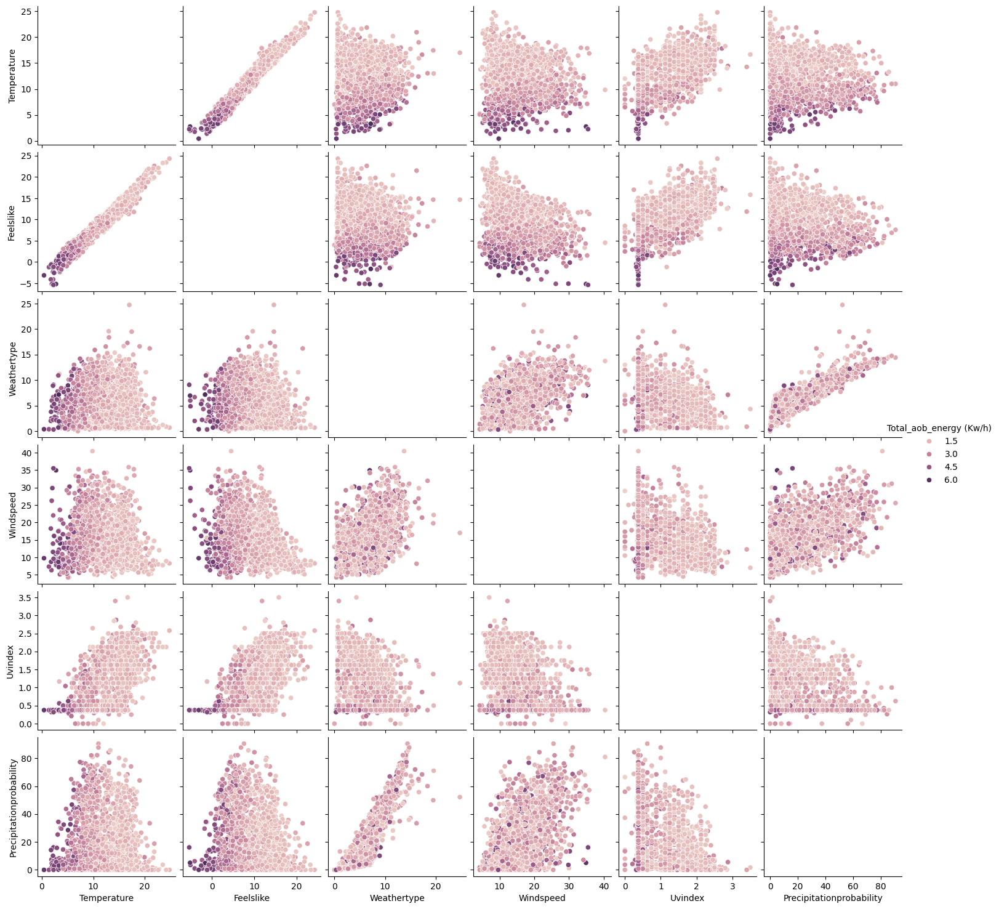

In [36]:
# Create the pairplot
pairplot = sns.pairplot(data_daily_cleaned, hue='Total_aob_energy')

# Ensure legend is created and then retrieve it
# Use pairplot._legend, which should exist after creating the pairplot
legend = pairplot._legend

# Check if the legend exists before trying to set the title
if legend is not None:
    legend.set_title("Total_aob_energy (Kw/h)")

# Show the plot
plt.show()

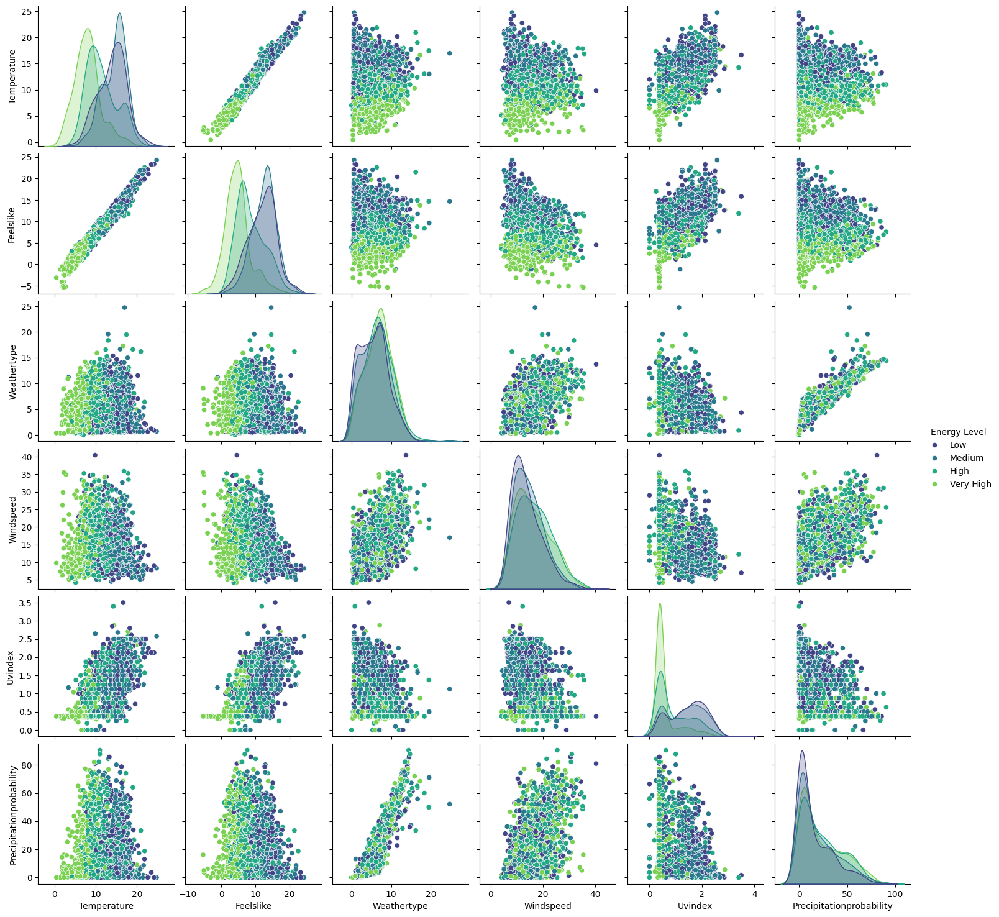

In [41]:
energy_bins = pd.qcut(data_daily_cleaned['Total_aob_energy'], q=4, labels=["Low", "Medium", "High", "Very High"])
# Drop these columns from the DataFrame
# df = df.drop(columns=columns_to_drop)


data_daily_cleaned['Energy Level'] = energy_bins
data_daily_cleaned = data_daily_cleaned.drop(['Total_aob_energy'], axis = 1)
# Plot using pairplot with the new 'Energy Level' column as hue
sns.pairplot(data_daily_cleaned, hue='Energy Level', palette="viridis")

In [104]:
data_daily.dropna(inplace=True)

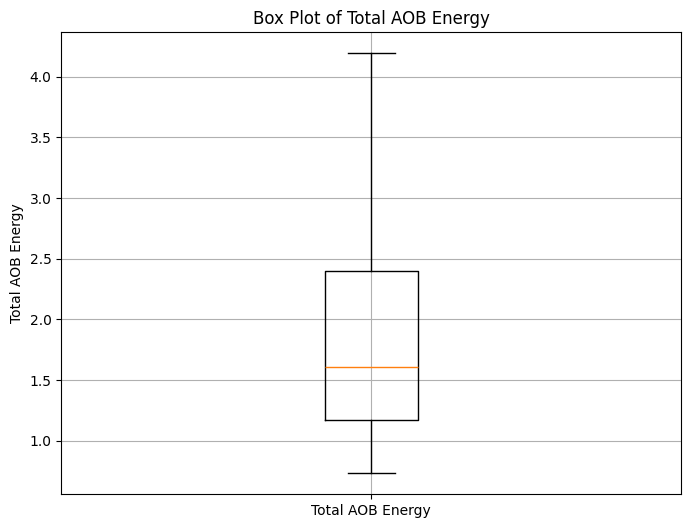

In [144]:

plt.figure(figsize=(8, 6))  # Set the figure size for better visibility
plt.boxplot(data_daily['Total_aob_energy'])
plt.title('Box Plot of Total AOB Energy')  # Adding a title
plt.ylabel('Total AOB Energy')  # Labeling the y-axis
plt.xticks([1], ['Total AOB Energy'])  # Labeling x-axis ticks
plt.grid(True)  # Adding a grid for better readability
plt.show()  # Display the plot

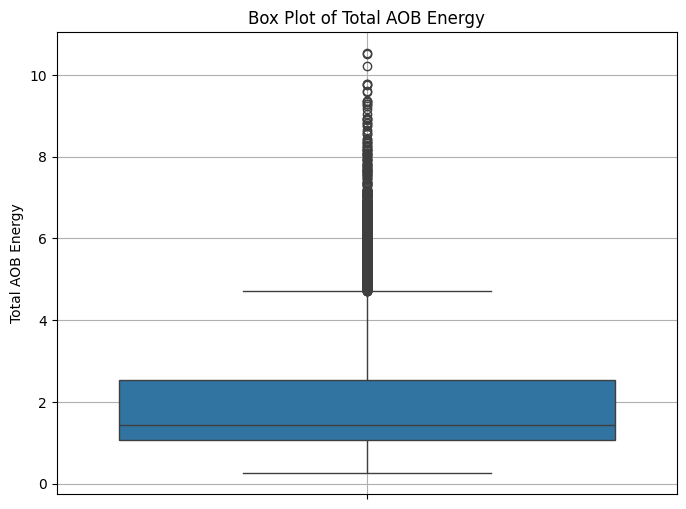

In [76]:
# Creating a box plot using Seaborn, which might provide a more aesthetically pleasing result by default
plt.figure(figsize=(8, 6))  # Set the figure size for better visibility
sns.boxplot(data=df_filtered, y='Total_aob_energy')
plt.title('Box Plot of Total AOB Energy')  # Adding a title
plt.ylabel('Total AOB Energy')  # Labeling the y-axis
plt.grid(True)  # Adding a grid for better readability
plt.show()  # Display the plot

In [47]:
# df['Total_aob_energy'] = df['Total_aob_energy'].astype(int)

In [63]:
zero_count = (df["Total_aob_energy"] < 0.3).sum()

In [64]:
print(zero_count)

22


In [107]:
df_filtered = df[df['Total_aob_energy'] > 1.0]

In [21]:
df_filtered.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 17270 entries, 2022-01-01 00:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   17270 non-null  bool   
 1   Bank holiday              17270 non-null  bool   
 2   Year                      17270 non-null  float64
 3   Temperature               17270 non-null  float64
 4   Feelslike                 17270 non-null  float64
 5   Weathertype               17270 non-null  float64
 6   Windspeed                 17270 non-null  float64
 7   Uvindex                   17270 non-null  float64
 8   Precipitationprobability  17270 non-null  float64
 9   Month_sin                 17270 non-null  float64
 10  Month_cos                 17270 non-null  float64
 11  Hour_sin                  17270 non-null  float64
 12  Hour_cos                  17270 non-null  float64
 13  Day of week_si

In [133]:
data_daily = data_daily.dropna()

In [154]:
df_no_outlier = df[df['Total_aob_energy']<= 7]


In [155]:
df

,Weekend,Bank holiday,Year,Temperature,Feelslike,Weathertype,Windspeed,Uvindex,Precipitationprobability,Month_sin,Month_cos,Hour_sin,Hour_cos,Day of week_sin,Day of week_cos,Day of month_sin,Day of month_cos,Working_hours,Total_aob_energy
time,,,,,,,,,,,,,,,,,,,
2019-04-05 16:00:00+00:00,False,False,2019.0,13.0,10.0,7.0,16.0,2.0,3.0,8.660254e-01,-0.5,-0.866025,-0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,True,4.064825
2019-04-05 17:00:00+00:00,False,False,2019.0,13.0,10.0,7.0,16.0,2.0,3.0,8.660254e-01,-0.5,-0.965926,-0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,True,3.487356
2019-04-05 19:00:00+00:00,False,False,2019.0,12.0,9.0,7.0,13.0,1.0,4.0,8.660254e-01,-0.5,-0.965926,0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,False,1.962769
2019-04-05 20:00:00+00:00,False,False,2019.0,12.0,9.0,7.0,13.0,1.0,4.0,8.660254e-01,-0.5,-0.866025,0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,False,1.704142
2019-04-05 23:00:00+00:00,False,False,2019.0,10.0,7.0,7.0,11.0,0.0,4.0,8.660254e-01,-0.5,-0.258819,0.965926,-0.974928,-0.222521,8.486443e-01,0.528964,False,1.872508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00+00:00,True,False,2023.0,10.0,6.0,15.0,22.0,0.0,96.0,-2.449294e-16,1.0,-0.965926,0.258819,0.000000,1.000000,-2.449294e-16,1.000000,False,1.079359
2023-12-31 20:00:00+00:00,True,False,2023.0,10.0,6.0,15.0,22.0,0.0,97.0,-2.449294e-16,1.0,-0.866025,0.500000,0.000000,1.000000,-2.449294e-16,1.000000,False,2.365750
2023-12-31 21:00:00+00:00,True,False,2023.0,11.0,7.0,15.0,34.0,0.0,96.0,-2.449294e-16,1.0,-0.707107,0.707107,0.000000,1.000000,-2.449294e-16,1.000000,False,2.376105


In [81]:
df_filtered

,Weekend,Bank holiday,Year,Temperature,Feelslike,Weathertype,Windspeed,Uvindex,Precipitationprobability,Month_sin,Month_cos,Hour_sin,Hour_cos,Day of week_sin,Day of week_cos,Day of month_sin,Day of month_cos,Working_hours,Total_aob_energy
time,,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00+00:00,True,False,2022.0,11.0,8.0,9.0,18.0,0.0,35.0,5.000000e-01,0.866025,0.000000,1.000000,-0.781831,0.62349,2.012985e-01,0.97953,False,1.794784
2022-01-01 01:00:00+00:00,True,False,2022.0,11.0,8.0,9.0,18.0,0.0,38.0,5.000000e-01,0.866025,0.258819,0.965926,-0.781831,0.62349,2.012985e-01,0.97953,False,1.513693
2022-01-01 02:00:00+00:00,True,False,2022.0,11.0,8.0,9.0,18.0,0.0,48.0,5.000000e-01,0.866025,0.500000,0.866025,-0.781831,0.62349,2.012985e-01,0.97953,False,1.155527
2022-01-01 03:00:00+00:00,True,False,2022.0,11.0,7.0,15.0,20.0,0.0,81.0,5.000000e-01,0.866025,0.707107,0.707107,-0.781831,0.62349,2.012985e-01,0.97953,False,1.531955
2022-01-01 04:00:00+00:00,True,False,2022.0,11.0,7.0,15.0,20.0,0.0,81.0,5.000000e-01,0.866025,0.866025,0.500000,-0.781831,0.62349,2.012985e-01,0.97953,False,1.563374
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00+00:00,True,False,2023.0,10.0,6.0,15.0,22.0,0.0,96.0,-2.449294e-16,1.000000,-0.965926,0.258819,0.000000,1.00000,-2.449294e-16,1.00000,False,1.079359
2023-12-31 20:00:00+00:00,True,False,2023.0,10.0,6.0,15.0,22.0,0.0,97.0,-2.449294e-16,1.000000,-0.866025,0.500000,0.000000,1.00000,-2.449294e-16,1.00000,False,2.365750
2023-12-31 21:00:00+00:00,True,False,2023.0,11.0,7.0,15.0,34.0,0.0,96.0,-2.449294e-16,1.000000,-0.707107,0.707107,0.000000,1.00000,-2.449294e-16,1.00000,False,2.376105


In [82]:
X = df_filtered.drop(['Year','Total_aob_energy'], axis=1)  # Assuming 'energy_consumption' is the target variable
y = df_filtered['Total_aob_energy']

In [50]:
data_daily_cleaned = data_daily_cleaned.dropna()

In [86]:
data_daily_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1723 entries, 2019-04-05 00:00:00+00:00 to 2023-12-31 00:00:00+00:00
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   1723 non-null   float64
 1   Bank holiday              1723 non-null   float64
 2   Year                      1723 non-null   float64
 3   Temperature               1723 non-null   float64
 4   Feelslike                 1723 non-null   float64
 5   Weathertype               1723 non-null   float64
 6   Windspeed                 1723 non-null   float64
 7   Uvindex                   1723 non-null   float64
 8   Precipitationprobability  1723 non-null   float64
 9   Month_sin                 1723 non-null   float64
 10  Month_cos                 1723 non-null   float64
 11  Hour_sin                  1723 non-null   float64
 12  Hour_cos                  1723 non-null   float64
 13  Day of week_sin

In [22]:
df_filtered_daily = df_filtered.resample('D').mean()
df_filtered_daily.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 730 entries, 2022-01-01 00:00:00+00:00 to 2023-12-31 00:00:00+00:00
Freq: D
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   730 non-null    float64
 1   Bank holiday              730 non-null    float64
 2   Year                      730 non-null    float64
 3   Temperature               730 non-null    float64
 4   Feelslike                 730 non-null    float64
 5   Weathertype               730 non-null    float64
 6   Windspeed                 730 non-null    float64
 7   Uvindex                   730 non-null    float64
 8   Precipitationprobability  730 non-null    float64
 9   Month_sin                 730 non-null    float64
 10  Month_cos                 730 non-null    float64
 11  Hour_sin                  730 non-null    float64
 12  Hour_cos                  730 non-null    float64
 13  Day of w

In [123]:
df_filtered_daily_rmoutlier = df_filtered_daily[df_filtered_daily["Total_aob_energy"]< 4.5]
df_filtered_daily_rmoutlier.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 709 entries, 2022-01-01 00:00:00+00:00 to 2023-12-31 00:00:00+00:00
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   709 non-null    float64
 1   Bank holiday              709 non-null    float64
 2   Year                      709 non-null    float64
 3   Temperature               709 non-null    float64
 4   Feelslike                 709 non-null    float64
 5   Weathertype               709 non-null    float64
 6   Windspeed                 709 non-null    float64
 7   Uvindex                   709 non-null    float64
 8   Precipitationprobability  709 non-null    float64
 9   Month_sin                 709 non-null    float64
 10  Month_cos                 709 non-null    float64
 11  Hour_sin                  709 non-null    float64
 12  Hour_cos                  709 non-null    float64
 13  Day of week_sin 

In [126]:
# Calculate the mean of the data excluding the outliers
mean_value = df_filtered_daily[df_filtered_daily["Total_aob_energy"] < 4.5]["Total_aob_energy"].mean()

# Replace values greater than or equal to 4.5 with the calculated mean
df_filtered_daily["Total_aob_energy"] = df_filtered_daily["Total_aob_energy"].apply(lambda x: mean_value if x >= 4.5 else x)

In [23]:
X_day = df_filtered_daily.drop(['Total_aob_energy','Year'], axis = 1)
y_day = df_filtered_daily['Total_aob_energy']

In [94]:
X

,Weekend,Bank holiday,Temperature,Feelslike,Weathertype,Windspeed,Uvindex,Precipitationprobability,Month_sin,Month_cos,Hour_sin,Hour_cos,Day of week_sin,Day of week_cos,Day of month_sin,Day of month_cos,Working_hours
time,,,,,,,,,,,,,,,,,
2019-04-05 16:00:00+00:00,False,False,13.0,10.0,7.0,16.0,2.0,3.0,8.660254e-01,-0.5,-0.866025,-0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,True
2019-04-05 17:00:00+00:00,False,False,13.0,10.0,7.0,16.0,2.0,3.0,8.660254e-01,-0.5,-0.965926,-0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,True
2019-04-05 19:00:00+00:00,False,False,12.0,9.0,7.0,13.0,1.0,4.0,8.660254e-01,-0.5,-0.965926,0.258819,-0.974928,-0.222521,8.486443e-01,0.528964,False
2019-04-05 20:00:00+00:00,False,False,12.0,9.0,7.0,13.0,1.0,4.0,8.660254e-01,-0.5,-0.866025,0.500000,-0.974928,-0.222521,8.486443e-01,0.528964,False
2019-04-05 23:00:00+00:00,False,False,10.0,7.0,7.0,11.0,0.0,4.0,8.660254e-01,-0.5,-0.258819,0.965926,-0.974928,-0.222521,8.486443e-01,0.528964,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00+00:00,True,False,10.0,6.0,15.0,22.0,0.0,96.0,-2.449294e-16,1.0,-0.965926,0.258819,0.000000,1.000000,-2.449294e-16,1.000000,False
2023-12-31 20:00:00+00:00,True,False,10.0,6.0,15.0,22.0,0.0,97.0,-2.449294e-16,1.0,-0.866025,0.500000,0.000000,1.000000,-2.449294e-16,1.000000,False
2023-12-31 21:00:00+00:00,True,False,11.0,7.0,15.0,34.0,0.0,96.0,-2.449294e-16,1.0,-0.707107,0.707107,0.000000,1.000000,-2.449294e-16,1.000000,False


In [83]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)
# Model Training
# Linear Regression
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Random Forest
rf_model = RandomForestRegressor(n_estimators=100)
rf_model.fit(X_train, y_train)

#gradient-boosted regression model
gbr_model = GradientBoostingRegressor()
gbr_model.fit(X_train, y_train)

#Ridge Model 
ridge_model = Ridge()
ridge_model.fit(X_train, y_train)

#Lasso Model
lasso_model = Lasso()
lasso_model.fit(X_train, y_train)

#Support Vector Regression 
svr_model = SVR()
svr_model.fit(X_train, y_train)

# Model Evaluation
y_pred_lr = lr_model.predict(X_test)
y_pred_rf = rf_model.predict(X_test)
y_pred_gbr = gbr_model.predict(X_test)
y_pred_ridge = ridge_model.predict(X_test)
y_pred_lasso = lasso_model.predict(X_test)
y_pred_svr = svr_model.predict(X_test)

#https://stats.stackexchange.com/questions/255276/normalized-root-mean-square-error-nrmse-with-zero-mean-of-observed-value
# Calculate range of the target variable
y_range = np.max(y_test) - np.min(y_test)
# Calculate the mean of the target variable
y_mean = np.mean(y_test)
# Calculate RMSE for Linear Regression
lr_rmse = np.sqrt(mean_squared_error(y_test, y_pred_lr))
# Calculate Normalised RMSE for Linear Regression
lr_nrmse = lr_rmse / y_range
# Calculate rRMSE (relative RMSE) for Linear Regression, normalized by the mean of y_test
lr_rrmse = lr_rmse / y_mean
# Calculate MAE
lr_mae = np.mean(np.abs(y_test - y_pred_lr))
print("Mean Absolute Error (MAE) for Linear Regression:", lr_mae)
# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
lr_mape = np.mean(np.abs((y_test - y_pred_lr) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Linear Regression:", lr_mape, "%")

print("Linear Regression RMSE:", lr_rmse)
print("Linear Regression NRMSE:", lr_nrmse)
print("Linear Regression rRMSE:", lr_rrmse)



# Calculate normalised RMSE for Random Forest
rf_rmse = np.sqrt(mean_squared_error(y_test, y_pred_rf))
# Calculate Normalised RMSE for Random Forest
rf_nrmse = rf_rmse / y_range
# Calculate rRMSE (relative RMSE) for Random Forest, normalised by the mean of y_test
rf_rrmse = rf_rmse / y_mean
# Calculate MAE
rf_mae = np.mean(np.abs(y_test - y_pred_rf))
print("Mean Absolute Error (MAE) for Random Forest:", rf_mae)
# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
rf_mape = np.mean(np.abs((y_test - y_pred_rf) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Random Forest:", rf_mape, "%")
print("Random Forest RMSE:", rf_rmse)
print("Random Forest NRMSE:", rf_nrmse)
print("Random Forest rRMSE:", rf_rrmse)



# Calculate nomrlaised RMSE for Gradient-boosted Regression
gbr_rmse = np.sqrt(mean_squared_error(y_test, y_pred_gbr))
# Calculate Normalised RMSE for Gradient-boosted regression
gbr_nrmse = gbr_rmse / y_range
# Calculate rRMSE (relative RMSE) for Gradient boosting, normalised by the mean of y_test
gbr_rrmse = gbr_rmse / y_mean
# Calculate MAE
gbr_mae = np.mean(np.abs(y_test - y_pred_gbr))
print("Mean Absolute Error (MAE) for Gradient Boosting Regression:", gbr_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
gbr_mape = np.mean(np.abs((y_test - y_pred_gbr) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Gradient Boosting Regression:", gbr_mape, "%")
print("Gradient Boosting Regression RMSE:", gbr_rmse)
print("Gradient Boosting Regression NRMSE:", gbr_nrmse)
print("Gradient Boosting Regression rRMSE:", gbr_rrmse)

# Calculate nomrlaised RMSE for Ridge
ridge_rmse = np.sqrt(mean_squared_error(y_test, y_pred_ridge))
# Calculate Normalised RMSE for Ridge regression
ridge_nrmse = ridge_rmse / y_range
# Calculate rRMSE (relative RMSE) for Ridge, normalised by the mean of y_test
ridge_rrmse = ridge_rmse / y_mean
# Calculate MAE
ridge_mae = np.mean(np.abs(y_test - y_pred_ridge))
print("Mean Absolute Error (MAE) for Ridge:", ridge_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
ridge_mape = np.mean(np.abs((y_test - y_pred_ridge) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Ridge:", ridge_mape, "%")
print("Ridge RMSE:", ridge_rmse)
print("Ridge NRMSE:", ridge_nrmse)
print("Ridge rRMSE:", ridge_rrmse)



# Calculate nomrlaised RMSE for Lasso
lasso_rmse = np.sqrt(mean_squared_error(y_test, y_pred_lasso))
# Calculate Normalised RMSE for Lasso regression
lasso_nrmse = lasso_rmse / y_range
# Calculate rRMSE (relative RMSE) for Lasso, normalised by the mean of y_test
lasso_rrmse = lasso_rmse / y_mean
# Calculate MAE
lasso_mae = np.mean(np.abs(y_test - y_pred_lasso))
print("Mean Absolute Error (MAE) for Lasso:", lasso_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
lasso_mape = np.mean(np.abs((y_test - y_pred_lasso) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Lasso:", lasso_mape, "%")
print("Lasso RMSE:", lasso_rmse)
print("Lasso NRMSE:", lasso_nrmse)
print("Lasso rRMSE:", lasso_rrmse)

# Calculate nomrlaised RMSE for support vector regression
svr_rmse = np.sqrt(mean_squared_error(y_test, y_pred_svr))
# Calculate Normalised RMSE for support vector regression regression
svr_nrmse = svr_rmse / y_range
# Calculate rRMSE (relative RMSE) for support vector regression, normalised by the mean of y_test
svr_rrmse = svr_rmse / y_mean
# Calculate MAE
svr_mae = np.mean(np.abs(y_test - y_pred_svr))
print("Mean Absolute Error (MAE) for SVR:", svr_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
svr_mape = np.mean(np.abs((y_test - y_pred_svr) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for SVR:", svr_mape, "%")
print("SVR RMSE:", svr_rmse)
print("SVR NRMSE:", svr_nrmse)
print("SVR rRMSE:", svr_rrmse)

Mean Absolute Error (MAE) for Linear Regression: 0.6516810362144866
Mean Absolute Percentage Error (MAPE) for Linear Regression: 39.09413557984243 %
Linear Regression RMSE: 0.8553133027002742
Linear Regression NRMSE: 0.10683125335861288
Linear Regression rRMSE: 0.4548801666914541
Mean Absolute Error (MAE) for Random Forest: 0.5760988901282629
Mean Absolute Percentage Error (MAPE) for Random Forest: 29.691644889888725 %
Random Forest RMSE: 0.8462066858889346
Random Forest NRMSE: 0.10569380900373074
Random Forest rRMSE: 0.4500370064599231
Mean Absolute Error (MAE) for Gradient Boosting Regression: 0.5608733742191844
Mean Absolute Percentage Error (MAPE) for Gradient Boosting Regression: 29.534091302276693 %
Gradient Boosting Regression RMSE: 0.7943978164683662
Gradient Boosting Regression NRMSE: 0.09922272239977133
Gradient Boosting Regression rRMSE: 0.42248356249532903
Mean Absolute Error (MAE) for Ridge: 0.6516440743684857
Mean Absolute Percentage Error (MAPE) for Ridge: 39.09146343091

In [54]:
X_train, X_test, y_train, y_test = train_test_split(X_day, y_day, test_size=0.2, shuffle=False)
# Model Training
# Linear Regression
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Random Forest
rf_model = RandomForestRegressor(n_estimators=100)
rf_model.fit(X_train, y_train)

#gradient-boosted regression model
gbr_model = GradientBoostingRegressor()
gbr_model.fit(X_train, y_train)

#Ridge Model 
ridge_model = Ridge()
ridge_model.fit(X_train, y_train)

#Lasso Model
lasso_model = Lasso()
lasso_model.fit(X_train, y_train)

#Support Vector Regression 
svr_model = SVR()
svr_model.fit(X_train, y_train)

# Model Evaluation
y_pred_lr = lr_model.predict(X_test)
y_pred_rf = rf_model.predict(X_test)
y_pred_gbr = gbr_model.predict(X_test)
y_pred_ridge = ridge_model.predict(X_test)
y_pred_lasso = lasso_model.predict(X_test)
y_pred_svr = svr_model.predict(X_test)

#https://stats.stackexchange.com/questions/255276/normalized-root-mean-square-error-nrmse-with-zero-mean-of-observed-value
# Calculate range of the target variable
y_range = np.max(y_test) - np.min(y_test)
# Calculate the mean of the target variable
y_mean = np.mean(y_test)
# Calculate RMSE for Linear Regression
lr_rmse = np.sqrt(mean_squared_error(y_test, y_pred_lr))
# Calculate Normalised RMSE for Linear Regression
lr_nrmse = lr_rmse / y_range
# Calculate rRMSE (relative RMSE) for Linear Regression, normalized by the mean of y_test
lr_rrmse = lr_rmse / y_mean
# Calculate MAE
lr_mae = np.mean(np.abs(y_test - y_pred_lr))
print("Mean Absolute Error (MAE) for Linear Regression:", lr_mae)
# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
lr_mape = np.mean(np.abs((y_test - y_pred_lr) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Linear Regression:", lr_mape, "%")

print("Linear Regression RMSE:", lr_rmse)
print("Linear Regression NRMSE:", lr_nrmse)
print("Linear Regression rRMSE:", lr_rrmse)



# Calculate normalised RMSE for Random Forest
rf_rmse = np.sqrt(mean_squared_error(y_test, y_pred_rf))
# Calculate Normalised RMSE for Random Forest
rf_nrmse = rf_rmse / y_range
# Calculate rRMSE (relative RMSE) for Random Forest, normalised by the mean of y_test
rf_rrmse = rf_rmse / y_mean
# Calculate MAE
rf_mae = np.mean(np.abs(y_test - y_pred_rf))
print("Mean Absolute Error (MAE) for Random Forest:", rf_mae)
# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
rf_mape = np.mean(np.abs((y_test - y_pred_rf) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Random Forest:", rf_mape, "%")
print("Random Forest RMSE:", rf_rmse)
print("Random Forest NRMSE:", rf_nrmse)
print("Random Forest rRMSE:", rf_rrmse)



# Calculate nomrlaised RMSE for Gradient-boosted Regression
gbr_rmse = np.sqrt(mean_squared_error(y_test, y_pred_gbr))
# Calculate Normalised RMSE for Gradient-boosted regression
gbr_nrmse = gbr_rmse / y_range
# Calculate rRMSE (relative RMSE) for Gradient boosting, normalised by the mean of y_test
gbr_rrmse = gbr_rmse / y_mean
# Calculate MAE
gbr_mae = np.mean(np.abs(y_test - y_pred_gbr))
print("Mean Absolute Error (MAE) for Gradient Boosting Regression:", gbr_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
gbr_mape = np.mean(np.abs((y_test - y_pred_gbr) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Gradient Boosting Regression:", gbr_mape, "%")
print("Gradient Boosting Regression RMSE:", gbr_rmse)
print("Gradient Boosting Regression NRMSE:", gbr_nrmse)
print("Gradient Boosting Regression rRMSE:", gbr_rrmse)

# Calculate nomrlaised RMSE for Ridge
ridge_rmse = np.sqrt(mean_squared_error(y_test, y_pred_ridge))
# Calculate Normalised RMSE for Ridge regression
ridge_nrmse = ridge_rmse / y_range
# Calculate rRMSE (relative RMSE) for Ridge, normalised by the mean of y_test
ridge_rrmse = ridge_rmse / y_mean
# Calculate MAE
ridge_mae = np.mean(np.abs(y_test - y_pred_ridge))
print("Mean Absolute Error (MAE) for Ridge:", ridge_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
ridge_mape = np.mean(np.abs((y_test - y_pred_ridge) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Ridge:", ridge_mape, "%")
print("Ridge RMSE:", ridge_rmse)
print("Ridge NRMSE:", ridge_nrmse)
print("Ridge rRMSE:", ridge_rrmse)



# Calculate nomrlaised RMSE for Lasso
lasso_rmse = np.sqrt(mean_squared_error(y_test, y_pred_lasso))
# Calculate Normalised RMSE for Lasso regression
lasso_nrmse = lasso_rmse / y_range
# Calculate rRMSE (relative RMSE) for Lasso, normalised by the mean of y_test
lasso_rrmse = lasso_rmse / y_mean
# Calculate MAE
lasso_mae = np.mean(np.abs(y_test - y_pred_lasso))
print("Mean Absolute Error (MAE) for Lasso:", lasso_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
lasso_mape = np.mean(np.abs((y_test - y_pred_lasso) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for Lasso:", lasso_mape, "%")
print("Lasso RMSE:", lasso_rmse)
print("Lasso NRMSE:", lasso_nrmse)
print("Lasso rRMSE:", lasso_rrmse)

# Calculate nomrlaised RMSE for support vector regression
svr_rmse = np.sqrt(mean_squared_error(y_test, y_pred_svr))
# Calculate Normalised RMSE for support vector regression regression
svr_nrmse = svr_rmse / y_range
# Calculate rRMSE (relative RMSE) for support vector regression, normalised by the mean of y_test
svr_rrmse = svr_rmse / y_mean
# Calculate MAE
svr_mae = np.mean(np.abs(y_test - y_pred_svr))
print("Mean Absolute Error (MAE) for SVR:", svr_mae)

# Calculate MAPE
# Note: We add a small number to the denominator to avoid division by zero in case y_test contains zeros.
svr_mape = np.mean(np.abs((y_test - y_pred_svr) / (y_test + 1e-10))) * 100
print("Mean Absolute Percentage Error (MAPE) for SVR:", svr_mape, "%")
print("SVR RMSE:", svr_rmse)
print("SVR NRMSE:", svr_nrmse)
print("SVR rRMSE:", svr_rrmse)
# Calculate R² score for Linear Regression
lr_r2 = r2_score(y_test, y_pred_lr)

# Calculate RMSE, NRMSE, rRMSE, MAE, and MAPE as before
# Add R² to the output
print("Linear Regression R²:", lr_r2)

# Calculate R² score for Random Forest
rf_r2 = r2_score(y_test, y_pred_rf)
print("Random Forest R²:", rf_r2)

# Calculate R² score for Gradient Boosting Regression
gbr_r2 = r2_score(y_test, y_pred_gbr)
print("Gradient Boosting Regression R²:", gbr_r2)

# Calculate R² score for Ridge
ridge_r2 = r2_score(y_test, y_pred_ridge)
print("Ridge R²:", ridge_r2)

# Calculate R² score for Lasso
lasso_r2 = r2_score(y_test, y_pred_lasso)
print("Lasso R²:", lasso_r2)

# Calculate R² score for Support Vector Regression
svr_r2 = r2_score(y_test, y_pred_svr)
print("SVR R²:", svr_r2)

Mean Absolute Error (MAE) for Linear Regression: 0.37020322348517254
Mean Absolute Percentage Error (MAPE) for Linear Regression: 21.593488186979613 %
Linear Regression RMSE: 0.4638045004239904
Linear Regression NRMSE: 0.12185265637320458
Linear Regression rRMSE: 0.24616193878358664
Mean Absolute Error (MAE) for Random Forest: 0.30201765308716133
Mean Absolute Percentage Error (MAPE) for Random Forest: 15.302011970805266 %
Random Forest RMSE: 0.41176643865376417
Random Forest NRMSE: 0.10818099934223933
Random Forest rRMSE: 0.21854299553446171
Mean Absolute Error (MAE) for Gradient Boosting Regression: 0.29087107130824114
Mean Absolute Percentage Error (MAPE) for Gradient Boosting Regression: 14.752288932903484 %
Gradient Boosting Regression RMSE: 0.3954117873820566
Gradient Boosting Regression NRMSE: 0.10388423702170732
Gradient Boosting Regression rRMSE: 0.2098628454680163
Mean Absolute Error (MAE) for Ridge: 0.36767613591558146
Mean Absolute Percentage Error (MAPE) for Ridge: 21.3708

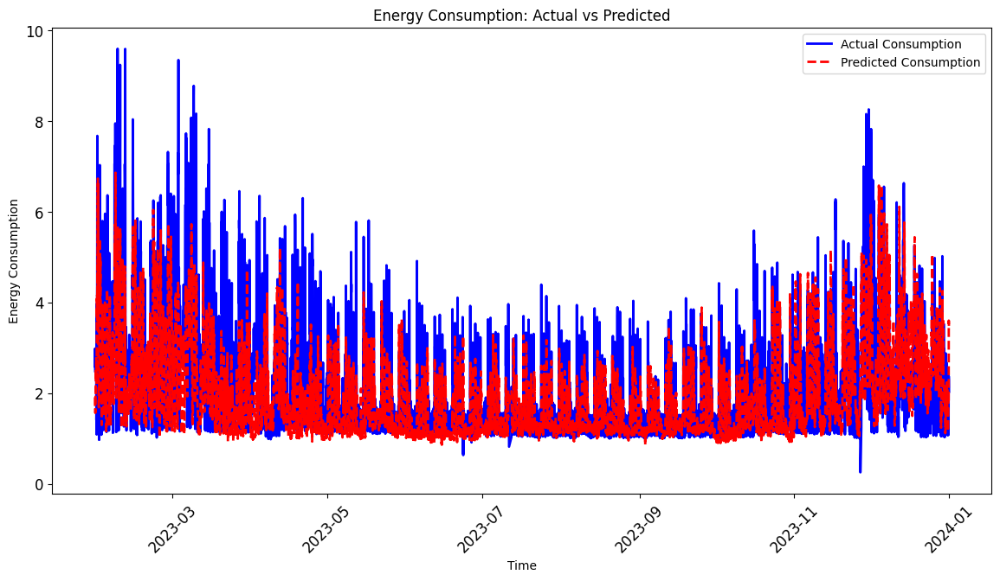

In [58]:
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
}, index=y_test.index)  # Use 'dates' as the index

# Ensure the DataFrame is sorted by date
df_error.sort_index(inplace=True)

# Plotting
plt.figure(figsize=(14, 7))
plt.plot(df_error.index, df_error['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
plt.plot(df_error.index, df_error['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)

plt.title('Energy Consumption: Actual vs Predicted')
plt.xlabel('Time')
plt.ylabel('Energy Consumption')
plt.legend()

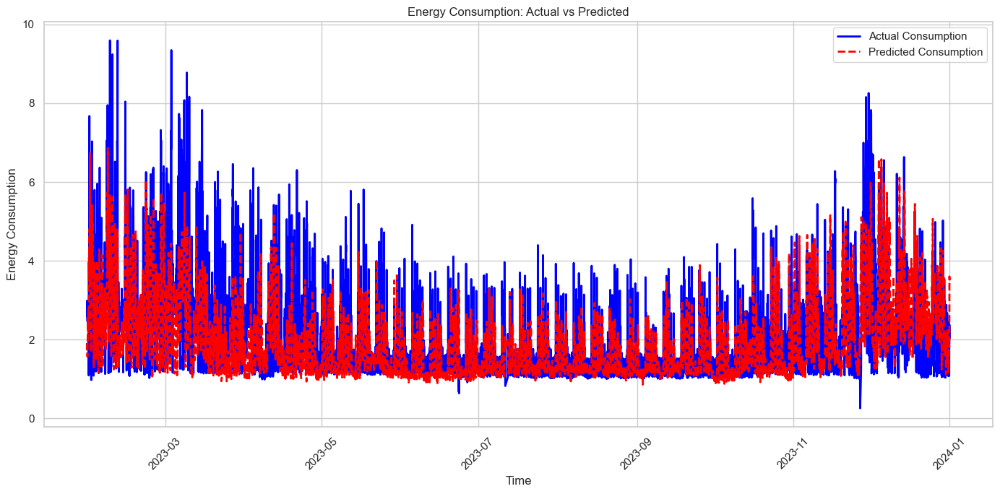

In [60]:

# Create a DataFrame for easier plotting
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
})

# Sort the DataFrame by date if it's not already sorted

# Plotting
sns.set_theme(style="whitegrid")  # This sets a nice background grid and improves overall aesthetics

plt.figure(figsize=(14, 7))
plt.plot(df_error.index, df_error['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
plt.plot(df_error.index, df_error['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

plt.title('Energy Consumption: Actual vs Predicted')
plt.xlabel('Time')
plt.ylabel('Energy Consumption')
plt.legend()
plt.xticks(rotation=45)  # Rotate date labels for better readability

# Optionally, you can limit the displayed range to a specific period for a clearer view
# plt.xlim([pd.Timestamp('YYYY-MM-DD'), pd.Timestamp('YYYY-MM-DD')])

plt.tight_layout()  # Adjust the layout to make room for the rotated date labels
plt.show()

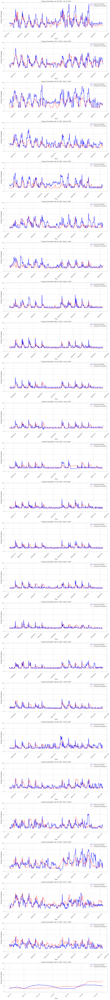

In [61]:
# Create a DataFrame for easier plotting
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
})

# Ensure the DataFrame is sorted by date if it's not already sorted
df_error.sort_index(inplace=True)

# Set the theme for seaborn plots
sns.set_theme(style="whitegrid")

# Determine the number of two-week periods in the test data
two_weeks = pd.Timedelta(weeks=2)
start_date = df_error.index.min()
end_date = df_error.index.max()
num_plots = (end_date - start_date) // two_weeks + 1

# Generate subplots for each two-week period
fig, axes = plt.subplots(num_plots, 1, figsize=(14, 5*num_plots), sharey=True)

for i in range(num_plots):
    start_period = start_date + i * two_weeks
    end_period = min(start_date + (i+1) * two_weeks, end_date)
    
    # Filter data for the current two-week period
    df_period = df_error[start_period:end_period]

    # Plot actual vs predicted consumption for the current period
    axes[i].plot(df_period.index, df_period['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
    axes[i].plot(df_period.index, df_period['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

    axes[i].set_title(f'Energy Consumption: {start_period.strftime("%b %d, %Y")} - {end_period.strftime("%b %d, %Y")}')
    axes[i].set_xlabel('Time')
    axes[i].set_ylabel('Energy Consumption')
    axes[i].legend()
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()  # Adjust the layout to make room for rotated date labels
plt.show()


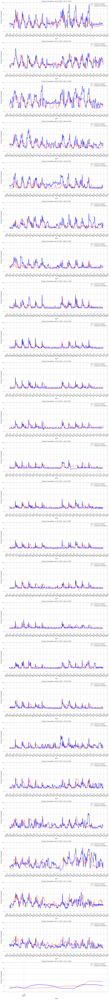

In [64]:
from matplotlib.dates import DateFormatter, HourLocator

# Create a DataFrame for easier plotting
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
})

# Ensure the DataFrame is sorted by date if it's not already sorted
df_error.sort_index(inplace=True)

# Set the theme for seaborn plots
sns.set_theme(style="whitegrid")

# Determine the number of two-week periods in the test data
two_weeks = pd.Timedelta(weeks=2)
start_date = df_error.index.min()
end_date = df_error.index.max()
num_plots = (end_date - start_date) // two_weeks + 1

# Generate subplots for each two-week period
fig, axes = plt.subplots(num_plots, 1, figsize=(14, 5*num_plots), sharey=True)

for i in range(num_plots):
    start_period = start_date + i * two_weeks
    end_period = min(start_date + (i+1) * two_weeks, end_date)
    
    # Filter data for the current two-week period
    df_period = df_error[start_period:end_period]

    # Plot actual vs predicted consumption for the current period
    axes[i].plot(df_period.index, df_period['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
    axes[i].plot(df_period.index, df_period['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

    axes[i].set_title(f'Energy Consumption: {start_period.strftime("%b %d, %Y")} - {end_period.strftime("%b %d, %Y")}')
    axes[i].set_xlabel('Time')
    axes[i].set_ylabel('Energy Consumption')
    axes[i].legend()
    
    # Set major and minor ticks for the x-axis
    axes[i].xaxis.set_major_locator(HourLocator(byhour=[0, 12]))  # Major ticks at 0 and 12 hour
    axes[i].xaxis.set_minor_locator(HourLocator())  # Minor ticks for each hour
    axes[i].xaxis.set_major_formatter(DateFormatter('%b %d\n%H:%M'))  # Month Day and Hour:Minute
    axes[i].tick_params(axis='x', which='both', rotation=45)

plt.tight_layout()  # Adjust the layout to make room for rotated date labels
plt.show()


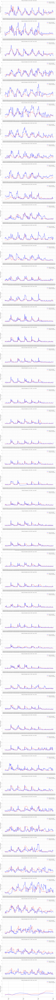

In [77]:
from matplotlib.dates import DateFormatter, HourLocator

# Create a DataFrame for easier plotting
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
})

# Ensure the DataFrame is sorted by date if it's not already sorted
df_error.sort_index(inplace=True)

# Set the theme for seaborn plots
sns.set_theme(style="whitegrid")

# Determine the number of one-week periods in the test data
one_week = pd.Timedelta(weeks=1)
start_date = df_error.index.min()
end_date = df_error.index.max()
num_plots = (end_date - start_date) // one_week + 1

# Generate subplots for each one-week period
fig, axes = plt.subplots(num_plots, 1, figsize=(14, 5*num_plots), sharey=True)

for i in range(num_plots):
    start_period = start_date + i * one_week
    end_period = min(start_date + (i+1) * one_week, end_date)
    
    # Filter data for the current one-week period
    df_period = df_error[start_period:end_period]

    # Plot actual vs predicted consumption for the current period
    axes[i].plot(df_period.index, df_period['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
    axes[i].plot(df_period.index, df_period['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

    axes[i].set_title(f'Energy Consumption: {start_period.strftime("%b %d, %Y")} - {end_period.strftime("%b %d, %Y")}')
    axes[i].set_ylabel('Energy Consumption')
    axes[i].legend()
    
    # Set major and minor ticks for the x-axis
    axes[i].xaxis.set_major_locator(HourLocator(interval=4))  # Major ticks every 4 hours
    axes[i].xaxis.set_minor_locator(HourLocator())  # Minor ticks for each hour
    axes[i].xaxis.set_major_formatter(DateFormatter('%b %d\n%H:%M'))  # Month Day and Hour:Minute
    axes[i].tick_params(axis='x', which='both', rotation=90)

plt.tight_layout()  # Adjust the layout to make room for rotated date labels
plt.show()


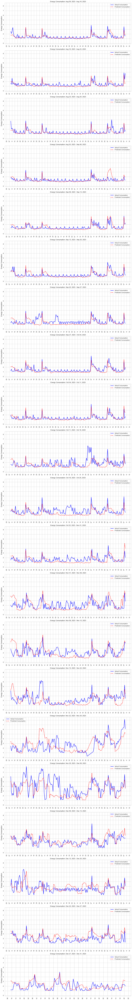

In [84]:
from matplotlib.dates import DateFormatter, HourLocator

# Create a DataFrame for easier plotting
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
})

# Ensure the DataFrame is sorted by date if it's not already sorted
df_error.sort_index(inplace=True)

# Set the theme for seaborn plots
sns.set_theme(style="whitegrid")

# Determine the number of one-week periods in the test data
one_week = pd.Timedelta(weeks=1)
start_date = df_error.index.min()
end_date = df_error.index.max()
num_plots = (end_date - start_date) // one_week + 1

# Generate subplots for each one-week period
fig, axes = plt.subplots(num_plots, 1, figsize=(14, 5*num_plots), sharey=True)

for i in range(num_plots):
    start_period = start_date + i * one_week
    end_period = min(start_date + (i+1) * one_week, end_date)
    
    # Filter data for the current one-week period
    df_period = df_error[start_period:end_period]

    # Plot actual vs predicted consumption for the current period
    axes[i].plot(df_period.index, df_period['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
    axes[i].plot(df_period.index, df_period['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

    axes[i].set_title(f'Energy Consumption: {start_period.strftime("%b %d, %Y")} - {end_period.strftime("%b %d, %Y")}')
    axes[i].set_ylabel('Energy Consumption')
    axes[i].legend()
    
    # Custom x-axis labels to show hours and date changes
    def custom_date_formatter(x, pos):
        dt = mdates.num2date(x)
        if dt.hour == 0:
            return dt.strftime('%b %d')  # Show date if the hour is midnight
        else:
            return dt.strftime('%H')  # Show hour otherwise

    axes[i].xaxis.set_major_locator(HourLocator(interval=4))  # Major ticks every 4 hours
    axes[i].xaxis.set_minor_locator(HourLocator())  # Minor ticks for each hour
    axes[i].xaxis.set_major_formatter(custom_date_formatter)
    axes[i].tick_params(axis='x', which='both', rotation=90)

plt.tight_layout()  # Adjust the layout to make room for rotated date labels
plt.show()


In [80]:
df_filtered.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 17270 entries, 2022-01-01 00:00:00+00:00 to 2023-12-31 23:00:00+00:00
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Weekend                   17270 non-null  bool   
 1   Bank holiday              17270 non-null  bool   
 2   Year                      17270 non-null  float64
 3   Temperature               17270 non-null  float64
 4   Feelslike                 17270 non-null  float64
 5   Weathertype               17270 non-null  float64
 6   Windspeed                 17270 non-null  float64
 7   Uvindex                   17270 non-null  float64
 8   Precipitationprobability  17270 non-null  float64
 9   Month_sin                 17270 non-null  float64
 10  Month_cos                 17270 non-null  float64
 11  Hour_sin                  17270 non-null  float64
 12  Hour_cos                  17270 non-null  float64
 13  Day of week_si

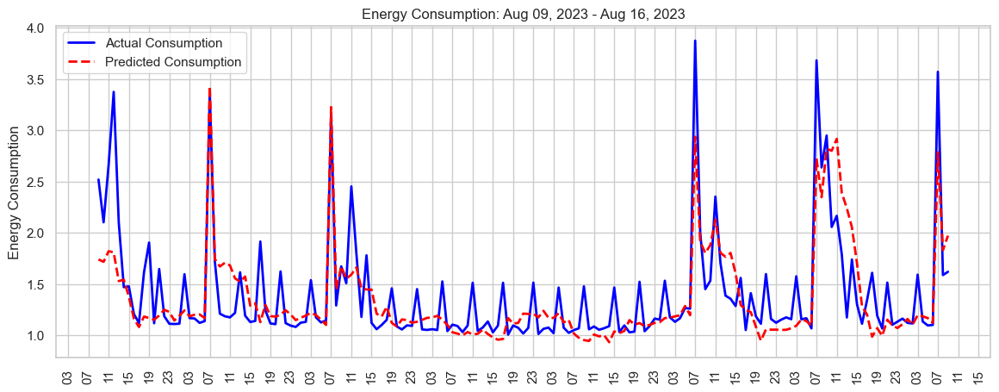

In [88]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from matplotlib.dates import DateFormatter, HourLocator
from matplotlib.animation import FuncAnimation, PillowWriter

# Create a DataFrame for easier plotting
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
})

# Ensure the DataFrame is sorted by date if it's not already sorted
df_error.sort_index(inplace=True)

# Set the theme for seaborn plots
sns.set_theme(style="whitegrid",palette="pastel")

# Determine the number of one-week periods in the test data
one_week = pd.Timedelta(weeks=1)
start_date = df_error.index.min()
end_date = df_error.index.max()
num_plots = (end_date - start_date) // one_week + 1

# Initialize figure
fig, ax = plt.subplots(figsize=(14, 5))

def animate(i):
    start_period = start_date + i * one_week
    end_period = min(start_date + (i+1) * one_week, end_date)
    
    # Filter data for the current one-week period
    df_period = df_error[start_period:end_period]

    # Clear previous plot
    ax.clear()

    # Plot actual vs predicted consumption for the current period
    ax.plot(df_period.index, df_period['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
    ax.plot(df_period.index, df_period['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

    ax.set_title(f'Energy Consumption: {start_period.strftime("%b %d, %Y")} - {end_period.strftime("%b %d, %Y")}')
    ax.set_ylabel('Energy Consumption')
    ax.legend()
    
    # Custom x-axis labels to show hours and date changes
    def custom_date_formatter(x, pos):
        dt = mdates.num2date(x)
        if dt.hour == 0:
            return dt.strftime('%b %d')  # Show date if the hour is midnight
        else:
            return dt.strftime('%H')  # Show hour otherwise

    ax.xaxis.set_major_locator(HourLocator(interval=4))  # Major ticks every 4 hours
    ax.xaxis.set_minor_locator(HourLocator())  # Minor ticks for each hour
    ax.xaxis.set_major_formatter(custom_date_formatter)
    ax.tick_params(axis='x', which='both', rotation=90)

# Create animation
ani = FuncAnimation(fig, animate, frames=num_plots, interval=5000)  # 5 seconds per scene

# Save animation as GIF
writer = PillowWriter(fps=1)
ani.save("energy_consumption_postcovid(2022).gif", writer=writer)


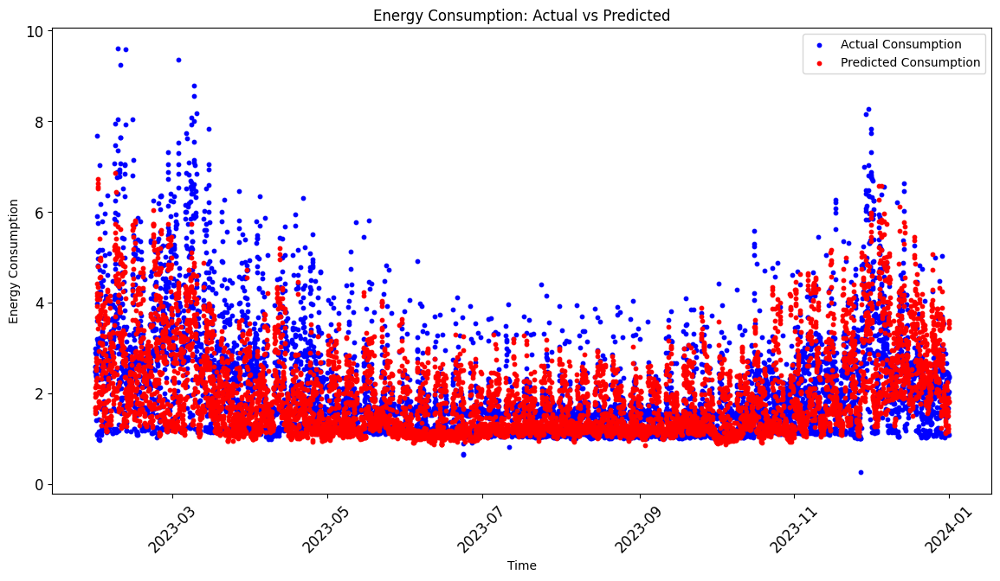

In [59]:
# Create a scatter plot for both actual and predicted consumption
plt.figure(figsize=(14, 7))
plt.scatter(df_error.index, df_error['Actual Consumption'], label='Actual Consumption', color='blue', s=10)  # Ensure s is set to a reasonable value for dots
plt.scatter(df_error.index, df_error['Predicted Consumption'], label='Predicted Consumption', color='red', s=10)

# # Add continuous lines through the dots for visual trend observation
# plt.plot(df_error.index, df_error['Actual Consumption'], color='blue', linewidth=2, alpha=0.5)
# plt.plot(df_error.index, df_error['Predicted Consumption'], color='red', linestyle='--', linewidth=2, alpha=0.5)

plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)

plt.title('Energy Consumption: Actual vs Predicted')
plt.xlabel('Time')
plt.ylabel('Energy Consumption')
plt.legend()
plt.show()

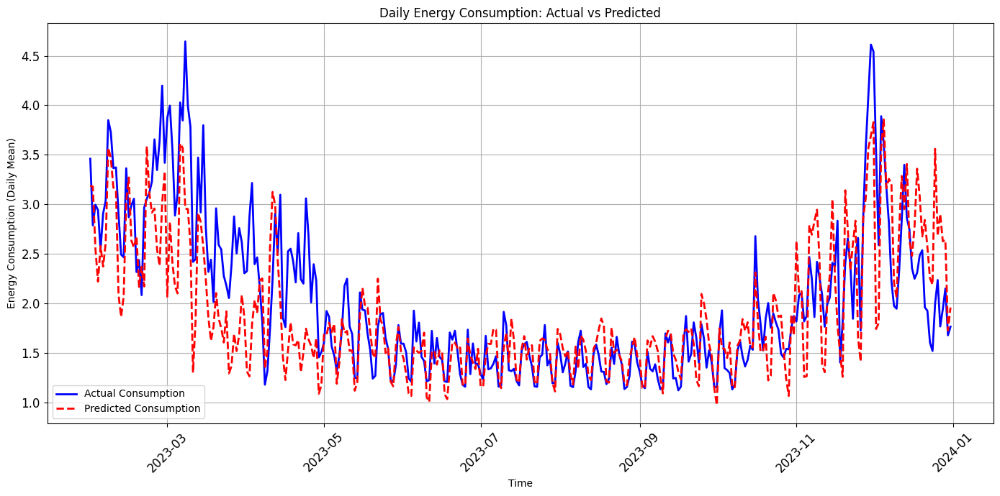

In [153]:
df_error = pd.DataFrame({
    'Actual Consumption': y_test,
    'Predicted Consumption': y_pred_rf
}, index=y_test.index)  # Use 'dates' as the index

daily_df_error = df_error.resample('D').mean()

# Plotting
plt.figure(figsize=(14, 7))
plt.plot(daily_df_error.index, daily_df_error['Actual Consumption'], label='Actual Consumption', color='blue', linewidth=2)
plt.plot(daily_df_error.index, daily_df_error['Predicted Consumption'], label='Predicted Consumption', color='red', linestyle='--', linewidth=2)

plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)

plt.title('Daily Energy Consumption: Actual vs Predicted')
plt.xlabel('Time')
plt.ylabel('Energy Consumption (Daily Mean)')
plt.legend()
plt.grid(True)  # Optional: Add grid for better readability
plt.tight_layout()  # Adjust layout to make sure everything fits without overlap
plt.show()

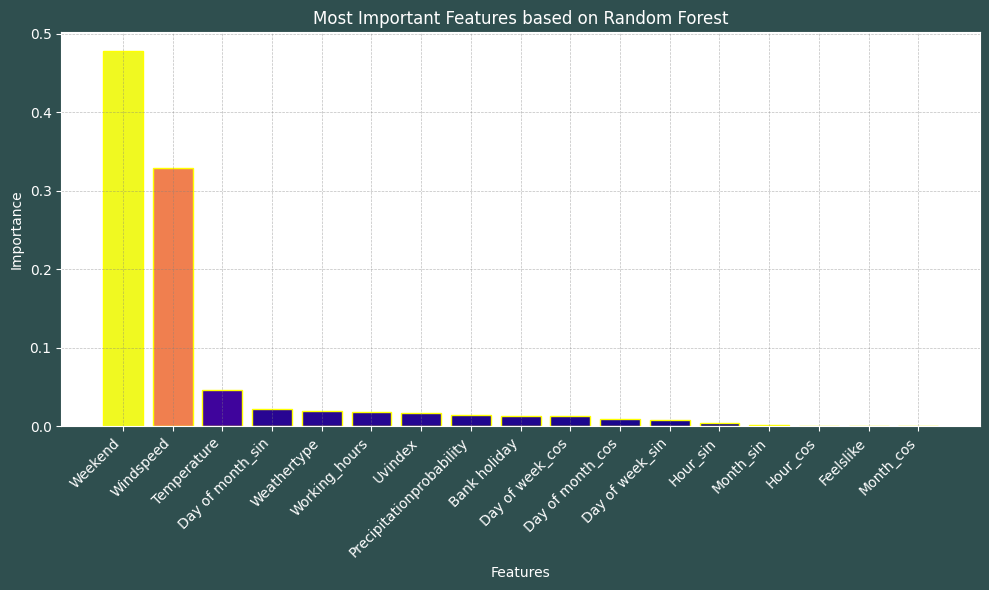

In [25]:
feature_names = X_train.columns
# Get feature importances
importances = rf_model.feature_importances_

# Sort feature importances in descending order and select the top 10
indices = np.argsort(importances)
indices= indices[::-1]

# Rearrange feature names so they match the sorted feature importances
names = [feature_names[i] for i in indices]

normalized_importances = importances[indices] / importances[indices].max()

# Generate a color for each importance score using the plasma colormap
colors = [plt.cm.plasma(i) for i in normalized_importances]

plt.figure(figsize=(10, 6), facecolor='darkslategray')
plt.title("Most Important Features based on Random Forest", color='white')

# Plot bars with the generated colors
for i, color in enumerate(colors):
    plt.bar(i, importances[indices][i], color=color, edgecolor='yellow')

# Assuming 'names' contains the feature names corresponding to 'indices'
plt.xticks(range(len(indices)), [names[i] for i in indices], rotation=45, ha='right', color='white')

plt.xlabel('Features', color='white')
plt.ylabel('Importance', color='white')
plt.tick_params(axis='x', colors='white')
plt.tick_params(axis='y', colors='white')

plt.grid(True, color='gray', linestyle='--', linewidth=0.5, alpha=0.5)

for spine in plt.gca().spines.values():
    spine.set_edgecolor('white')

plt.tight_layout()
plt.show()

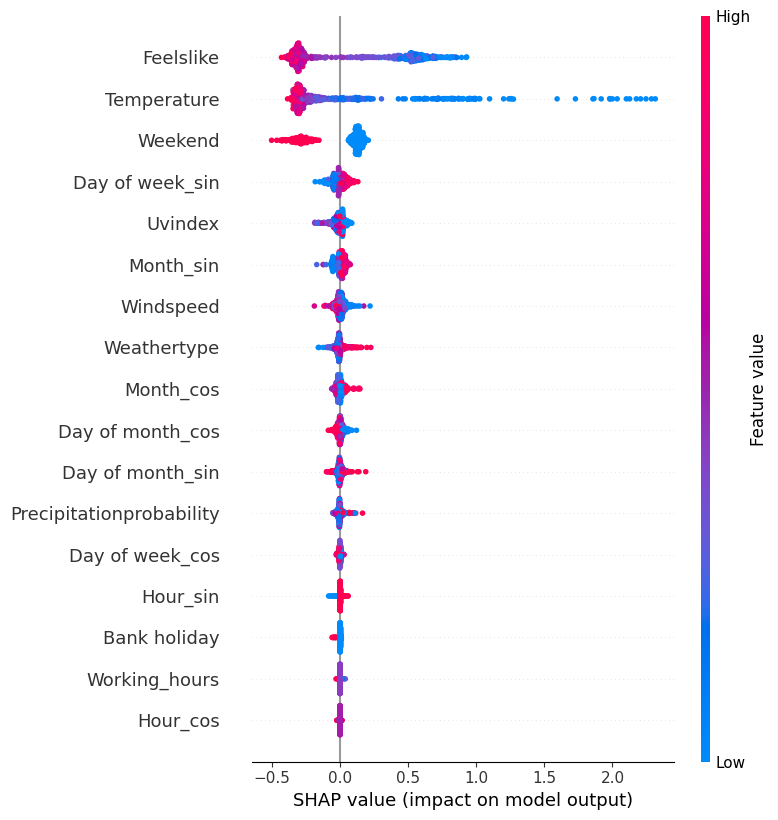

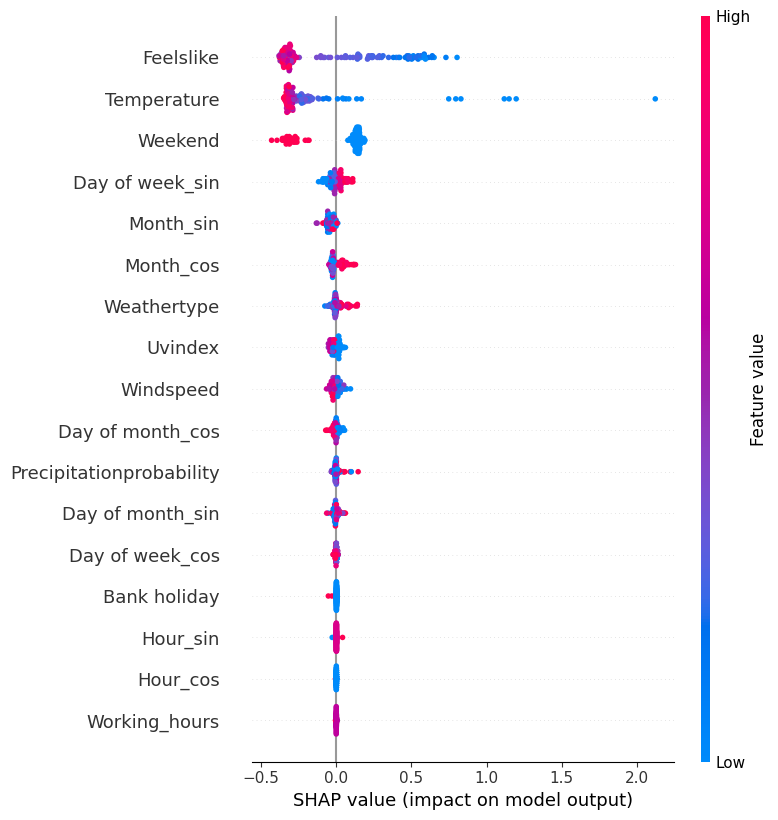

In [26]:
# Analyzing SHAP values for the training data
explainer_train = shap.TreeExplainer(rf_model)
shap_values_train = explainer_train.shap_values(X_train)
shap.summary_plot(shap_values_train, X_train, title="SHAP Summary Plot - Training Data")

# Analyzing SHAP values for the testing data
explainer_test = shap.TreeExplainer(rf_model)
shap_values_test = explainer_test.shap_values(X_test)
shap.summary_plot(shap_values_test, X_test, title="SHAP Summary Plot - Testing Data")


In [38]:
# Create a LIME explainer for regression
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X_train.columns.tolist(),
    mode='regression'
)

# Explain an instance from the test set for regression
idx = 5  # Index of the instance to explain
exp = explainer.explain_instance(X_test.iloc[idx], rf_model.predict, num_features=10)
exp.show_in_notebook(show_table=True, show_all=False)

c:\AOB\AOB_Energy_Consumption_Analysis_Prediction\.venv\Lib\site-packages\lime\discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
c:\AOB\AOB_Energy_Consumption_Analysis_Prediction\.venv\Lib\site-packages\lime\discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
c:\AOB\AOB_Energy_Consumption_Analysis_Prediction\.venv\Lib\site-packages\lime\lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will alwa

In [ ]:
# Create LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X_train.columns.tolist(),
    mode='regression'
)

# Choose a sample of instances to explain
sample_indices = np.random.choice(X_test.index, size=100, replace=False)  # Adjust size as needed
lime_results = []

for idx in sample_indices:
    instance = X_test.loc[idx]
    exp = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict, num_features=10)
    lime_results.append(exp.as_list())

# Convert results to DataFrame for analysis
lime_df = pd.DataFrame(index=sample_indices, columns=X_train.columns)

for idx, single_result in zip(sample_indices, lime_results):
    for feature, value in single_result:
        lime_df.loc[idx, feature] = value

# Aggregate results
feature_importance_summary = lime_df.mean().sort_values(ascending=False)

print(feature_importance_summary)

In [ ]:

# Single feature partial dependence plot
feature_to_plot = 'Temprature'  # Replace 'feature_name' with the actual name of the feature you want to analyze
pdp_dist = pdp.PDPIsolate(model=rf_model, dataset=X_train, model_features=X_train.columns.tolist(), feature=feature_to_plot)
pdp.PDPIsolatePlotEngine(pdp_dist, feature_to_plot)
plt.show()

# Partial dependence plot for interaction between two features
features_to_plot = ['Weekend', 'feelslike']  # Replace 'feature1' and 'feature2' with actual feature names
inter1 = pdp.pdp_interact(model=rf_model, dataset=X_train, model_features=X_train.columns.tolist(), features=features_to_plot)
pdp.pdp_interact_plot(pdp_interact_out=inter1, feature_names=features_to_plot, plot_type='contour')
plt.show()

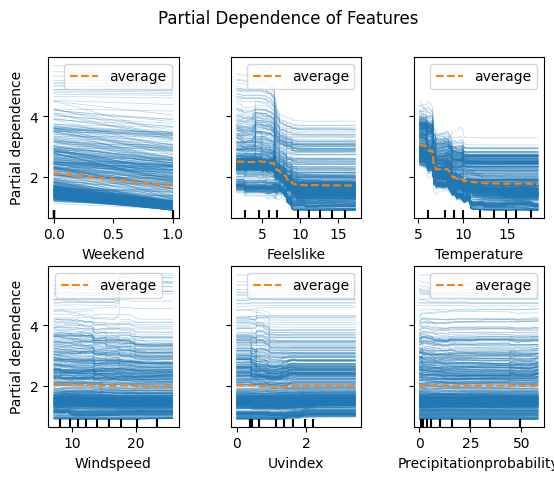

In [50]:
from sklearn.inspection import PartialDependenceDisplay

features = ['Weekend', 'Feelslike','Temperature', 'Windspeed','Uvindex','Precipitationprobability']  # Feature names as strings
display = PartialDependenceDisplay.from_estimator(
    rf_model,
    X_train,
    features,
    kind="both"  # Can display individual and average effects
)
display.figure_.suptitle('Partial Dependence of Features')
display.figure_.subplots_adjust(wspace=0.4, hspace=0.3)  # Adjust spacing if necessary
plt.show()


In [51]:
result = permutation_importance(rf_model, X_test, y_test, n_repeats=10, random_state=42, n_jobs=-1)

# Get the importance and corresponding std
importance_sorted_idx = np.argsort(result.importances_mean)[::-1]
importances = pd.DataFrame({
    "features": X_test.columns[importance_sorted_idx],
    "importance_mean": result.importances_mean[importance_sorted_idx],
    "importance_std": result.importances_std[importance_sorted_idx]
})

# Print the feature importance
print(importances)

                    features  importance_mean  importance_std
0                Temperature         0.421451        0.042380
1                  Feelslike         0.325152        0.023856
2                    Weekend         0.135743        0.016494
3            Day of week_sin         0.014867        0.009532
4                  Windspeed         0.006344        0.006030
5                Weathertype         0.002255        0.007175
6                    Uvindex         0.001309        0.006415
7               Bank holiday         0.000977        0.000642
8                   Hour_sin         0.000954        0.000593
9              Working_hours         0.000137        0.000290
10  Precipitationprobability        -0.000051        0.003540
11                  Hour_cos        -0.000251        0.000638
12          Day of month_cos        -0.001417        0.003669
13                 Month_sin        -0.001693        0.002259
14           Day of week_cos        -0.001818        0.002170
15      

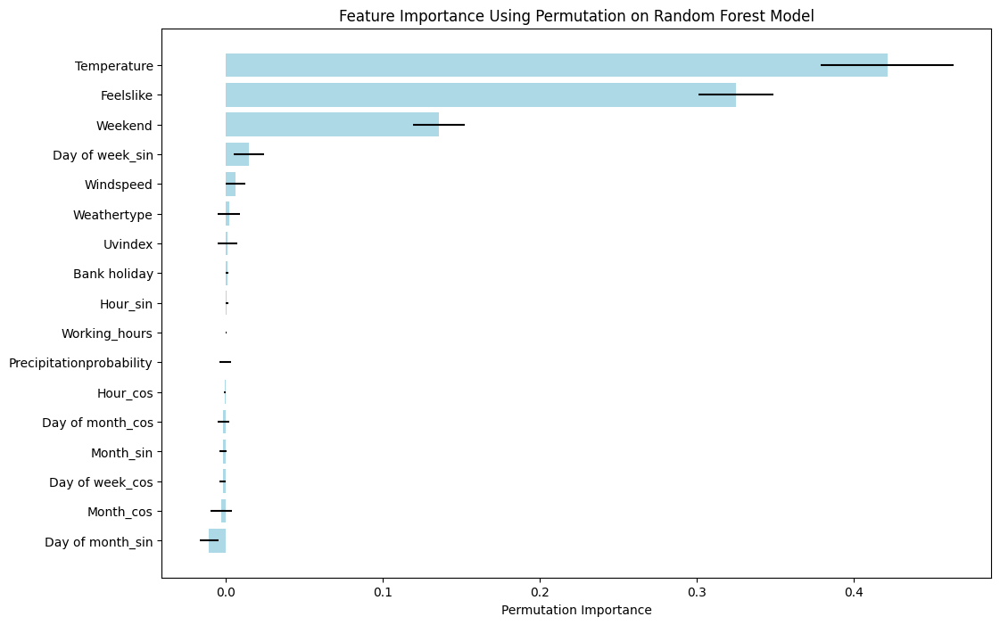

In [53]:
result = permutation_importance(rf_model, X_test, y_test, n_repeats=10, random_state=42, n_jobs=-1)

# Get the importances and their standard deviations
importances = result.importances_mean
std = result.importances_std
features = X_test.columns

# Sorting the features by importance
sorted_idx = np.argsort(importances)[::-1]
plt.figure(figsize=(12, 8))
plt.barh(range(len(sorted_idx)), importances[sorted_idx], color='lightblue', xerr=std[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), features[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Feature Importance Using Permutation on Random Forest Model')
plt.gca().invert_yaxis()  # Invert axis to have the most important at the top
plt.show()

In [68]:
def replace_with_nearest_nonzero(series):
    """ Replace 0 with the nearest non-zero value in a pandas Series. """
    nonzero_indices = series.nonzero()[0]
    for i in range(len(series)):
        if series[i] < 0.2:
            # Find the nearest non-zero index
            nearest_nonzero_index = min(nonzero_indices, key=lambda x: abs(x-i))
            series[i] = series[nearest_nonzero_index]
    return series

In [69]:
df['Total_aob_energy'] = replace_with_nearest_nonzero(df['Total_aob_energy'])

AttributeError: 'Series' object has no attribute 'nonzero'

In [70]:
# df1 = df

In [80]:
# def replace_with_nearest_nonzero(series):
#     """ Replace 0 with the nearest non-zero value in a pandas Series. """
#     # Convert series to numpy array
#     arr = series.to_numpy()
#     # Get indices where the array is not zero
#     nonzero_indices = np.nonzero(arr)[0]
#     # Iterate over all elements of the array
#     for i in range(len(arr)):
#         if arr[i] < 0.3:
#             # Calculate distances to all non-zero elements
#             distances = np.abs(nonzero_indices - i)
#             # Find the index of the nearest non-zero element
#             nearest_index = nonzero_indices[np.argmin(distances)]
#             # Replace zero with the nearest non-zero element
#             arr[i] = arr[nearest_index]
#     return arr

# # Apply the function to the 'Total_aob_energy' column
# df1['Total_aob_energy'] = replace_with_nearest_nonzero(df1['Total_aob_energy'])


In [101]:
zero_count = (df["Total_aob_energy"] < 0.75).sum()

In [102]:
print(zero_count)

81


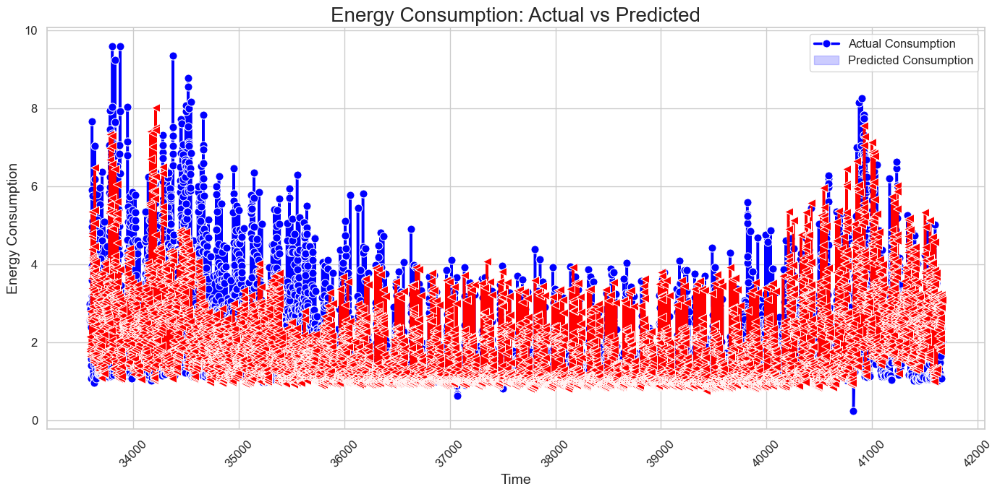

In [113]:
sns.set(style="whitegrid")  # This sets a nice background grid and improves overall aesthetics

# Plotting with Seaborn's lineplot function for automatic handling of datetime x-axis and improved aesthetics
plt.figure(figsize=(14, 7))

sns.lineplot(data=df_error, palette=['blue', 'red'], linewidth=2.5, dashes=False, markers=["o", "<"], markersize=8)

plt.title('Energy Consumption: Actual vs Predicted', fontsize=20)
plt.xlabel('Time', fontsize=14)
plt.ylabel('Energy Consumption', fontsize=14)
plt.legend(labels=['Actual Consumption', 'Predicted Consumption'], fontsize=12)

# Improve readability of the x-axis labels
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)

# Adjust the layout
plt.tight_layout()

In [121]:
# Visualise the scatterplot matrix: training data
df_train = X_train.join(y_train)

sns.pairplot(df_train, hue="Total_aob_energy")
plt.show()

KeyboardInterrupt: 

In [124]:
df_test = X_test.join(y_test)

sns.pairplot(df_test, hue="Total_aob_energy")
plt.show()

KeyboardInterrupt: 